In [1]:
import folium as fl
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
from shapely.geometry import Point
import statsmodels.api as sm
import json
import numpy as np
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import warnings

In [2]:
school_districts = 'data/school_districts.geojson'
housing_data = 'data/kc_house_data.csv'

In [3]:
data = pd.read_csv(housing_data)

In [4]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sewer_system,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_built,yr_renovated,address,lat,long
0,7399300360,5/24/2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,PUBLIC,1180,0,0,40,1969,0,"2102 Southeast 21st Court, Renton, Washington ...",47.461975,-122.19052
1,8910500230,12/13/2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,PUBLIC,1570,1570,0,240,1950,0,"11231 Greenwood Avenue North, Seattle, Washing...",47.711525,-122.35591
2,1180000275,9/29/2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,PUBLIC,1580,1580,0,0,1956,0,"8504 South 113th Street, Seattle, Washington 9...",47.502045,-122.22520
3,1604601802,12/14/2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,PUBLIC,1090,1070,200,270,2010,0,"4079 Letitia Avenue South, Seattle, Washington...",47.566110,-122.29020
4,8562780790,8/24/2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,PUBLIC,1120,550,550,30,2012,0,"2193 Northwest Talus Drive, Issaquah, Washingt...",47.532470,-122.07188


In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30155 entries, 0 to 30154
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             30155 non-null  int64  
 1   date           30155 non-null  object 
 2   price          30155 non-null  float64
 3   bedrooms       30155 non-null  int64  
 4   bathrooms      30155 non-null  float64
 5   sqft_living    30155 non-null  int64  
 6   sqft_lot       30155 non-null  int64  
 7   floors         30155 non-null  float64
 8   waterfront     30155 non-null  object 
 9   greenbelt      30155 non-null  object 
 10  nuisance       30155 non-null  object 
 11  view           30155 non-null  object 
 12  condition      30155 non-null  object 
 13  grade          30155 non-null  object 
 14  heat_source    30123 non-null  object 
 15  sewer_system   30141 non-null  object 
 16  sqft_above     30155 non-null  int64  
 17  sqft_basement  30155 non-null  int64  
 18  sqft_g

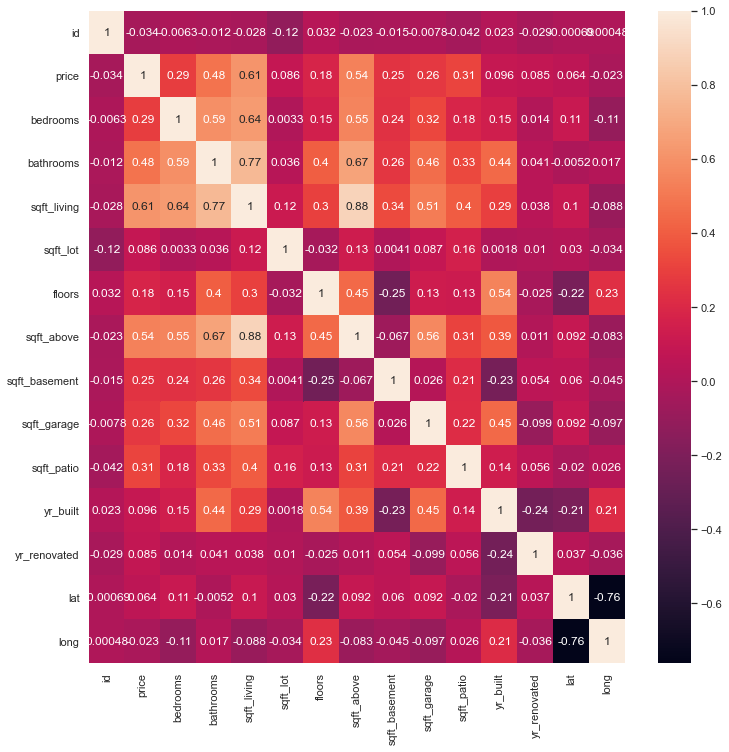

In [6]:
sns.set(rc={'figure.figsize': (12,12)})
sns.heatmap(data.corr(), annot=True);

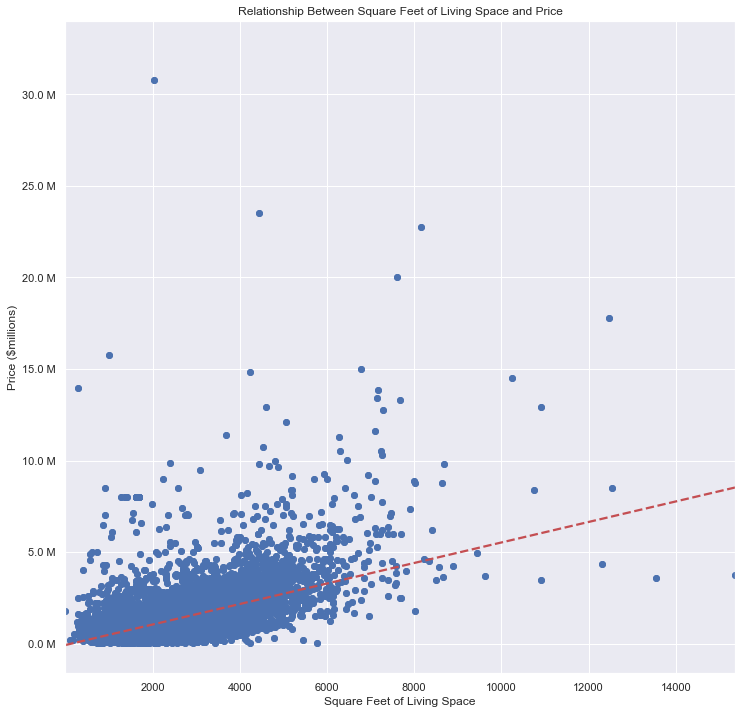

In [7]:
# create plot of square feet of living space vs price
fig, ax = plt.subplots()

plt.scatter(x=data["sqft_living"], y=data["price"])
sns.regplot(data = data, x = 'sqft_living', y = 'price', line_kws={'ls':'--', 'color': 'r'}, ci = None)
ax.set_xlabel('Square Feet of Living Space')
ax.set_ylabel('Price ($millions)')
ax.set_title('Relationship Between Square Feet of Living Space and Price')

# format y axis to show values in millions
def million_formatter(x, pos):
    '''
    Takes two inputs (a tick value ``x`` and a position ``pos``), and returns a 
    string containing the corresponding tick label and the value divided by
    1,000,000 with an M at the end to indicate a value in millions
    '''
    return "%.1f M" % (x/1E6)

ax.set_yticks(range(-1000000, 35000000, 1000000), minor = True)
ax.yaxis.set_major_formatter(million_formatter);


In [8]:
data['lat'].min(), data['lat'].max()

(21.27424, 64.82406999999999)

In [9]:
data['long'].min(), data['long'].max()

(-157.79148, -70.07434)

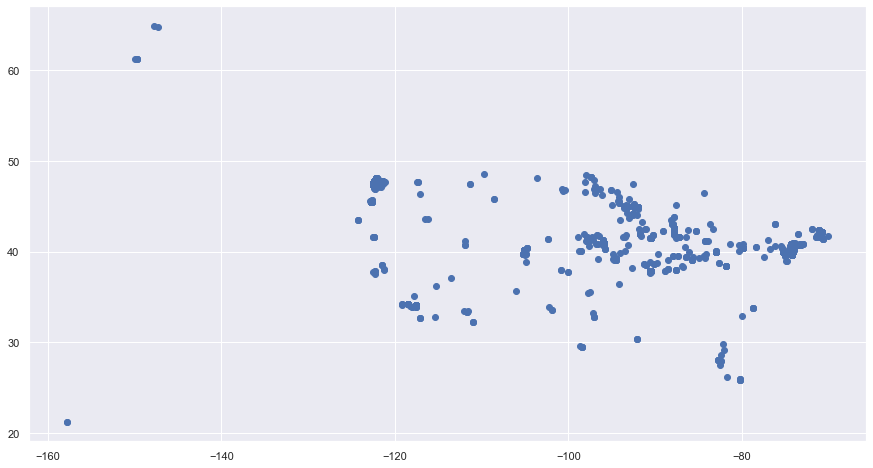

In [10]:
fig, ax = plt.subplots(figsize=[15,8])
ax.scatter(data['long'], data['lat']);

In [11]:
data = data.loc[(data['long'] > -140) & (data['long'] < -121.6) & (data['lat'] > 47.1) & (data['lat'] < 47.8)]

In [12]:
to_drop = data.loc[((data['long'] < -121.9) & (data['lat'] > 47.78)) |
                   ((data['long'] < -122.2) & (data['lat'] < 47.2)) |
                   ((data['long'] > -121.8) & (data['lat'] < 47.2))
                  ]

In [13]:
data = data.drop(index=to_drop.index)

### For our analysis, we're only interested in the zipcode of the location, so we'll drop all address other info

In [14]:
data['zipcode'] = data.address.str.split(',', expand = True)[2].str.strip().str.split(' ', expand = True)[1]
# Because of some oddly formatted addresses, we need to manually assign the zipcode for four rows:
warnings.filterwarnings('ignore')
data['zipcode'].loc[(data['id'] == 139000091) | (data['id'] == 139000123) | (data['id'] == 139000125)] = 98126
data['zipcode'].loc[data['id'] == 4083306403] = 98103
data.drop(['address'], axis=1, inplace=True)
data['zipcode'] = data['zipcode'].astype(int)

In [15]:
data['date'] = pd.DatetimeIndex(data['date']).year
data['age'] = data['date'] - data['yr_built']
data = data.drop(columns=['yr_built'])

In [16]:
# data = data.dropna()

In [17]:
data.to_csv("data/kc_house_data_clean.csv")

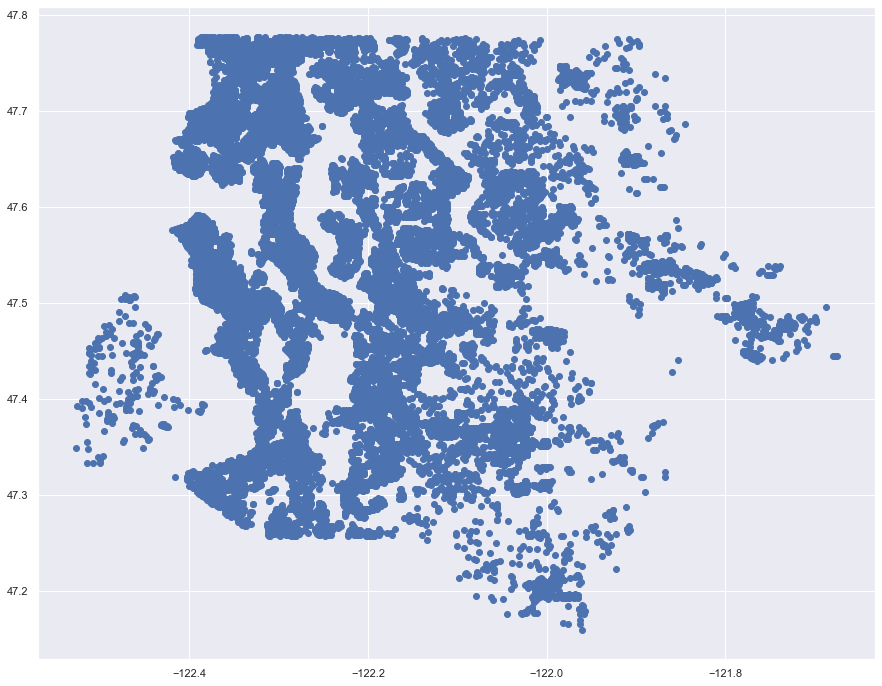

In [18]:
fig, ax = plt.subplots(figsize=[15,12])

ax.scatter(data['long'], data['lat']);

In [19]:
def plotPoint(df):
    fl.CircleMarker(location=[df['lat'], df['long']], radius=0.5, color='red').add_to(m)

In [20]:
m = fl.Map(location=[47.51, -122.0], zoom_start=10, control_scale=True,
           tiles='Stamen Terrain', attr="http://stamen.com")
fl.GeoJson(school_districts, tooltip=fl.GeoJsonTooltip(fields=['NAME'])).add_to(m)
data.apply(plotPoint, axis=1)
m

In [21]:
district_regions = json.load(open(school_districts))

In [22]:
district_nums = {}
for i in district_regions['features']:
    district_nums[float(i['properties']['OBJECTID']-1)] = i['properties']['NAME']

In [23]:
district_regions = gpd.GeoDataFrame.from_file('data/school_districts.shp')

In [24]:
houses = pd.DataFrame()

In [25]:
data['coords'] = list(zip(data['long'], data['lat']))
data['coords'] = data['coords'].apply(Point)

In [26]:
houses = gpd.GeoDataFrame(data['coords'], geometry='coords', crs=district_regions.crs)

In [27]:
house_in_districts = gpd.tools.sjoin(houses, district_regions, predicate="within", how='left')

In [28]:
house_in_districts = pd.DataFrame(house_in_districts)

In [29]:
data = data.join(house_in_districts, lsuffix='_left', rsuffix='_right')

In [30]:
data = data.dropna()

In [31]:
data = data.drop(columns=['coords_left', 'coords_right'])

In [32]:
data = data.rename(columns={'index_right':'district'})

In [33]:
data = data.replace({"district": district_nums})

In [34]:
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,greenbelt,...,sqft_above,sqft_basement,sqft_garage,sqft_patio,yr_renovated,lat,long,zipcode,age,district
0,7399300360,2022,675000.0,4,1.0,1180,7140,1.0,NO,NO,...,1180,0,0,40,0,47.461975,-122.19052,98055,53,Renton
1,8910500230,2021,920000.0,5,2.5,2770,6703,1.0,NO,NO,...,1570,1570,0,240,0,47.711525,-122.35591,98133,71,Seattle
2,1180000275,2021,311000.0,6,2.0,2880,6156,1.0,NO,NO,...,1580,1580,0,0,0,47.502045,-122.22520,98178,65,Renton
3,1604601802,2021,775000.0,3,3.0,2160,1400,2.0,NO,NO,...,1090,1070,200,270,0,47.566110,-122.29020,98118,11,Seattle
4,8562780790,2021,592500.0,2,2.0,1120,758,2.0,NO,NO,...,1120,550,550,30,0,47.532470,-122.07188,98027,9,Issaquah


In [35]:
data.to_csv('data/kc_house_data_districts.csv')

## Dummie out district column 
### $R^2_{adj}$: 0.559

In [36]:
model_data = data.join(pd.get_dummies(data['district'])).drop(columns=['district', 'Seattle'])

In [37]:
y = model_data['price']
X = sm.add_constant(model_data.drop(columns=['price', 'waterfront', 'greenbelt', 'nuisance', 'view', 'condition', 'grade', 'heat_source', 'sewer_system', 'date', 'id']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.560
Model:                            OLS   Adj. R-squared:                  0.559
Method:                 Least Squares   F-statistic:                     1158.
Date:                Wed, 29 Mar 2023   Prob (F-statistic):               0.00
Time:                        18:21:38   Log-Likelihood:            -4.2890e+05
No. Observations:               29149   AIC:                         8.579e+05
Df Residuals:                   29116   BIC:                         8.581e+05
Df Model:                          32                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const             -1.589e+08   1.68e+07     -9.473      0.000   -1.92e+08   -1.26e+08
bedrooms          -1.316e+05   4846.460    -27.148      0.000   -1.41e+05   -1.22e+05
bathrooms          8.633e+04   7133.194     12.102      0.000    7.23e+04       1e+05
sqft_living         270.7855     16.019     16.904      0.000     239.388     302.183
sqft_lot              0.5418      0.061      8.894      0.000       0.422       0.661
floors            -7.183e+04   9617.733     -7.469      0.000   -9.07e+04    -5.3e+04
sqft_above          314.4692     16.300     19.293      0.000     282.521     346.418
sqft_basement        91.0879     12.283      7.416      0.000      67.013     115.162
sqft_garage         -38.9107     17.515     -2.222      0.026     -73.240      -4.581
sqft_patio          212.4712     15.865     13.393      0.000     181.376     243.567
yr_renovated         56.6672      8.734      6.488      0.000      39.549      73.786
lat                1.159e+06   7.82e+04     14.823      0.000    1.01e+06    1.31e+06
long              -9.318e+05   7.76e+04    -12.006      0.000   -1.08e+06    -7.8e+05
zipcode            -101.6457    133.400     -0.762      0.446    -363.115     159.823
age                1398.9153    171.400      8.162      0.000    1062.964    1734.867
Auburn            -5.576e+04   3.42e+04     -1.629      0.103   -1.23e+05    1.13e+04
Bellevue            9.18e+05   2.79e+04     32.886      0.000    8.63e+05    9.73e+05
Enumclaw           1.244e+05   4.62e+04      2.695      0.007    3.39e+04    2.15e+05
Federal Way       -1.776e+05    3.2e+04     -5.549      0.000    -2.4e+05   -1.15e+05
Fife              -1.295e+05   6.55e+04     -1.976      0.048   -2.58e+05   -1068.531
Highline          -1.833e+05    2.2e+04     -8.338      0.000   -2.26e+05    -1.4e+05
Issaquah           3.313e+05   3.04e+04     10.917      0.000    2.72e+05    3.91e+05
Kent              -8.109e+04   2.92e+04     -2.774      0.006   -1.38e+05   -2.38e+04
Lake Washington    3.378e+05   2.48e+04     13.601      0.000    2.89e+05    3.86e+05
Mercer Island      1.043e+06   3.67e+04     28.439      0.000    9.71e+05    1.11e+06
Northshore        -1.392e+05   2.81e+04     -4.949      0.000   -1.94e+05   -8.41e+04
Renton            -4.439e+04   2.34e+04     -1.898      0.058   -9.02e+04    1451.625
Riverview         -1.112e+05   4.52e+04     -2.460      0.014      -2e+05   -2.26e+04
Shoreline         -3.078e+05    2.3e+04    -13.360      0.000   -3.53e+05   -2.63e+05
Snoqualmie Valley  3.007e+05   4.61e+04      6.517      0.000     2.1e+05    3.91e+05
Tahoma             5.984e+04   3.74e+04      1.600      0.110   -1.34e+04    1.33e+05
Tukwila           -2.037e+05   5.13e+04     -3.970      0.000   -3.04e+05   -1.03e+05
Vashon Island     -1.778e+05   4.91e+04     -3.620      0.000   -2.74e+05

## Dummie out additional object columns

### Dummie waterfront

In [38]:
model_data['waterfront'] = pd.get_dummies(model_data['waterfront'], drop_first=True).rename(columns={'YES': 'waterfront'})

In [39]:
X = sm.add_constant(model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'view', 'condition', 'grade', 'heat_source', 'sewer_system', 'date', 'id']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.592
Model:                            OLS   Adj. R-squared:                  0.592
Method:                 Least Squares   F-statistic:                     1281.
Date:                Wed, 29 Mar 2023   Prob (F-statistic):               0.00
Time:                        18:21:38   Log-Likelihood:            -4.2779e+05
No. Observations:               29149   AIC:                         8.556e+05
Df Residuals:                   29115   BIC:                         8.559e+05
Df Model:                          33                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const             -1.623e+08   1.62e+07    -10.046      0.000   -1.94e+08   -1.31e+08
bedrooms          -1.087e+05   4689.554    -23.185      0.000   -1.18e+05   -9.95e+04
bathrooms          7.933e+04   6868.196     11.550      0.000    6.59e+04    9.28e+04
sqft_living         242.3889     15.431     15.707      0.000     212.143     272.635
sqft_lot              0.4650      0.059      7.928      0.000       0.350       0.580
floors             -7.97e+04   9259.795     -8.607      0.000   -9.78e+04   -6.16e+04
waterfront         1.283e+06   2.67e+04     48.014      0.000    1.23e+06    1.34e+06
sqft_above          322.5200     15.692     20.554      0.000     291.764     353.276
sqft_basement        89.2091     11.824      7.545      0.000      66.034     112.384
sqft_garage          10.6115     16.892      0.628      0.530     -22.497      43.720
sqft_patio          154.1306     15.320     10.061      0.000     124.103     184.159
yr_renovated         30.9569      8.424      3.675      0.000      14.445      47.469
lat                1.138e+06   7.53e+04     15.110      0.000     9.9e+05    1.29e+06
long               -1.03e+06   7.47e+04    -13.778      0.000   -1.18e+06   -8.83e+05
zipcode            -179.0955    128.425     -1.395      0.163    -430.814      72.623
age                1038.0184    165.166      6.285      0.000     714.285    1361.752
Auburn            -8.755e+04    3.3e+04     -2.656      0.008   -1.52e+05   -2.29e+04
Bellevue           8.869e+05   2.69e+04     32.996      0.000    8.34e+05     9.4e+05
Enumclaw           1.184e+05   4.44e+04      2.663      0.008    3.12e+04    2.05e+05
Federal Way       -2.448e+05   3.08e+04     -7.936      0.000   -3.05e+05   -1.84e+05
Fife              -1.738e+05   6.31e+04     -2.755      0.006   -2.97e+05   -5.02e+04
Highline          -2.104e+05   2.12e+04     -9.943      0.000   -2.52e+05   -1.69e+05
Issaquah           3.239e+05   2.92e+04     11.085      0.000    2.67e+05    3.81e+05
Kent              -1.143e+05   2.82e+04     -4.059      0.000   -1.69e+05   -5.91e+04
Lake Washington     3.31e+05   2.39e+04     13.844      0.000    2.84e+05    3.78e+05
Mercer Island      9.697e+05   3.53e+04     27.450      0.000       9e+05    1.04e+06
Northshore        -1.478e+05   2.71e+04     -5.459      0.000   -2.01e+05   -9.47e+04
Renton            -6.719e+04   2.25e+04     -2.984      0.003   -1.11e+05   -2.31e+04
Riverview          -1.22e+05   4.35e+04     -2.803      0.005   -2.07e+05   -3.67e+04
Shoreline         -3.136e+05   2.22e+04    -14.140      0.000   -3.57e+05    -2.7e+05
Snoqualmie Valley  2.864e+05   4.44e+04      6.449      0.000    1.99e+05    3.73e+05
Tahoma             1.452e+04    3.6e+04      0.403      0.687    -5.6e+04    8.51e+04
Tukwila            -2.21e+05   4.94e+04     -4.473      0.000   -3.18e+05

### Dummie greenbelt

In [40]:
# model_data['greenbelt'] = pd.get_dummies(model_data['greenbelt'], drop_first=True).rename(columns={'YES': 'greenbelt'})

In [41]:
# X = sm.add_constant(model_data.drop(columns=['price', 'nuisance', 'view', 'condition', 'grade', 'heat_source', 'sewer_system', 'date', 'id']))
# model = sm.OLS(y, X)
# model.fit().summary()

### Dummie nuisance

In [42]:
# model_data['nuisance'] = pd.get_dummies(model_data['nuisance'], drop_first=True).rename(columns={'YES': 'nuisance'})

In [43]:
# X = sm.add_constant(model_data.drop(columns=['price', 'view', 'condition', 'grade', 'heat_source', 'sewer_system', 'date', 'id']))
# model = sm.OLS(y, X)
# model.fit().summary()

### Dummie view

In [44]:
view = pd.get_dummies(model_data['view'], prefix='view').drop(columns=['view_NONE'])
model_data = model_data.join(view).drop(columns=['view'])

In [45]:
X = sm.add_constant(model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'grade', 'heat_source', 'sewer_system', 'date', 'id']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.605
Model:                            OLS   Adj. R-squared:                  0.604
Method:                 Least Squares   F-statistic:                     1205.
Date:                Wed, 29 Mar 2023   Prob (F-statistic):               0.00
Time:                        18:21:38   Log-Likelihood:            -4.2732e+05
No. Observations:               29149   AIC:                         8.547e+05
Df Residuals:                   29111   BIC:                         8.550e+05
Df Model:                          37                                         
Covariance Type:            nonrobust                                         
=====================================================================================
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const             -1.319e+08    1.6e+07     -8.267      0.000   -1.63e+08   -1.01e+08
bedrooms          -9.759e+04   4634.769    -21.057      0.000   -1.07e+05   -8.85e+04
bathrooms          7.868e+04   6760.719     11.638      0.000    6.54e+04    9.19e+04
sqft_living         211.3461     15.239     13.869      0.000     181.478     241.215
sqft_lot              0.4756      0.058      8.224      0.000       0.362       0.589
floors            -7.997e+04   9116.251     -8.772      0.000   -9.78e+04   -6.21e+04
waterfront         8.107e+05   3.06e+04     26.497      0.000    7.51e+05    8.71e+05
sqft_above          331.5006     15.452     21.454      0.000     301.214     361.787
sqft_basement        74.6857     11.670      6.400      0.000      51.811      97.560
sqft_garage           7.4962     16.627      0.451      0.652     -25.093      40.085
sqft_patio          113.0763     15.175      7.451      0.000      83.332     142.821
yr_renovated         23.5000      8.297      2.832      0.005       7.238      39.762
lat                1.231e+06   7.43e+04     16.575      0.000    1.09e+06    1.38e+06
long               -8.78e+05   7.38e+04    -11.890      0.000   -1.02e+06   -7.33e+05
zipcode            -344.2385    126.735     -2.716      0.007    -592.646     -95.831
age                 874.1513    162.895      5.366      0.000     554.869    1193.434
Auburn            -8.349e+04   3.25e+04     -2.573      0.010   -1.47e+05   -1.99e+04
Bellevue           8.469e+05   2.65e+04     31.952      0.000    7.95e+05    8.99e+05
Enumclaw           7.705e+04   4.38e+04      1.759      0.079   -8805.440    1.63e+05
Federal Way       -2.234e+05   3.04e+04     -7.352      0.000   -2.83e+05   -1.64e+05
Fife              -1.404e+05   6.21e+04     -2.259      0.024   -2.62e+05   -1.86e+04
Highline          -1.875e+05   2.09e+04     -8.981      0.000   -2.28e+05   -1.47e+05
Issaquah           2.844e+05   2.88e+04      9.873      0.000    2.28e+05    3.41e+05
Kent              -1.158e+05   2.77e+04     -4.180      0.000    -1.7e+05   -6.15e+04
Lake Washington    3.051e+05   2.36e+04     12.943      0.000    2.59e+05    3.51e+05
Mercer Island      9.435e+05   3.49e+04     27.063      0.000    8.75e+05    1.01e+06
Northshore        -1.665e+05   2.67e+04     -6.244      0.000   -2.19e+05   -1.14e+05
Renton            -7.878e+04   2.22e+04     -3.553      0.000   -1.22e+05   -3.53e+04
Riverview          -1.82e+05   4.29e+04     -4.238      0.000   -2.66e+05   -9.78e+04
Shoreline         -3.174e+05   2.18e+04    -14.538      0.000    -3.6e+05   -2.75e+05
Snoqualmie Valley  2.265e+05   4.39e+04      5.164      0.000    1.41e+05    3.12e+05
Tahoma            -1256.8924   3.54e+04     -0.035      0.972   -7.07e+04    6.82e+04
Tukwila           -1.934e+05   4.86e+04     -3.976      0.000   -2.89e+05

### Dummie sewer system

In [46]:
sewer = pd.get_dummies(model_data['sewer_system'], prefix='sewer').drop(columns=['sewer_PUBLIC'])
model_data = model_data.join(sewer).drop(columns=['sewer_system'])

In [47]:
X = sm.add_constant(model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'grade', 'heat_source', 'date', 'id']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.605
Model:                            OLS   Adj. R-squared:                  0.605
Method:                 Least Squares   F-statistic:                     1116.
Date:                Wed, 29 Mar 2023   Prob (F-statistic):               0.00
Time:                        18:21:38   Log-Likelihood:            -4.2731e+05
No. Observations:               29149   AIC:                         8.547e+05
Df Residuals:                   29108   BIC:                         8.550e+05
Df Model:                          40                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                    -1.282e+08    1.6e+07     -8.016      0.000    -1.6e+08   -9.68e+07
bedrooms                 -9.866e+04   4643.560    -21.247      0.000   -1.08e+05   -8.96e+04
bathrooms                  7.82e+04   6761.403     11.566      0.000     6.5e+04    9.15e+04
sqft_living                212.6640     15.241     13.954      0.000     182.792     242.536
sqft_lot                     0.5297      0.060      8.824      0.000       0.412       0.647
floors                   -8.192e+04   9136.411     -8.967      0.000   -9.98e+04    -6.4e+04
waterfront                8.186e+05   3.07e+04     26.706      0.000    7.58e+05    8.79e+05
sqft_above                 330.5823     15.450     21.397      0.000     300.300     360.865
sqft_basement               74.1643     11.668      6.356      0.000      51.294      97.035
sqft_garage                  7.8602     16.623      0.473      0.636     -24.722      40.442
sqft_patio                 120.6984     15.336      7.870      0.000      90.639     150.758
yr_renovated                23.3499      8.295      2.815      0.005       7.092      39.608
lat                       1.223e+06   7.43e+04     16.456      0.000    1.08e+06    1.37e+06
long                      -8.34e+05   7.49e+04    -11.139      0.000   -9.81e+05   -6.87e+05
zipcode                   -323.6013    126.844     -2.551      0.011    -572.222     -74.981
age                        919.5635    163.406      5.627      0.000     599.280    1239.847
Auburn                   -8.182e+04   3.24e+04     -2.522      0.012   -1.45e+05   -1.82e+04
Bellevue                  8.407e+05   2.66e+04     31.655      0.000    7.89e+05    8.93e+05
Enumclaw                  7.158e+04   4.38e+04      1.633      0.102   -1.43e+04    1.57e+05
Federal Way              -2.183e+05   3.04e+04     -7.176      0.000   -2.78e+05   -1.59e+05
Fife                     -1.313e+05   6.22e+04     -2.112      0.035   -2.53e+05   -9461.301
Highline                 -1.849e+05   2.09e+04     -8.854      0.000   -2.26e+05   -1.44e+05
Issaquah                  2.851e+05   2.88e+04      9.900      0.000    2.29e+05    3.42e+05
Kent                     -1.172e+05   2.77e+04     -4.230      0.000   -1.72e+05   -6.29e+04
Lake Washington           3.051e+05   2.36e+04     12.948      0.000    2.59e+05    3.51e+05
Mercer Island             9.379e+05   3.49e+04     26.877      0.000    8.69e+05    1.01e+06
Northshore               -1.588e+05   2.68e+04     -5.934      0.000   -2.11e+05   -1.06e+05
Renton                   -8.014e+04   2.22e+04     -3.615      0.000   -1.24e+05   -3.67e+04
Riverview                -1.848e+05   4.29e+04     -4.304      0.000   -2.69e+05   -1.01e+05
Shoreline                -3.177e+05   2.18e+04    -14.558      0.000    -3.6e+05   -2.75e+05
Snoqualmie Val

### Dummie zipcode

In [48]:
zipcode = pd.get_dummies(model_data['zipcode'], prefix='zip').drop(columns=['zip_98042'])
model_data = model_data.join(zipcode).drop(columns=['zipcode'])

In [49]:
# X = sm.add_constant(model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'grade', 'heat_source', 'date', 'id']))
# model = sm.OLS(y, X)
# model.fit().summary()

### Dummie condition

In [50]:
model_data['grade'].value_counts()

7 Average        11543
8 Good            8851
9 Better          3587
6 Low Average     2834
10 Very Good      1347
11 Excellent       402
5 Fair             384
12 Luxury          122
4 Low               45
13 Mansion          24
3 Poor               9
2 Substandard        1
Name: grade, dtype: int64

In [51]:
grade_names = {'grade_' + col: 'grade_'+ ' '.join(col.split()[1:]) for col in pd.get_dummies(model_data['grade']).columns}
grade_names

{'grade_10 Very Good': 'grade_Very Good',
 'grade_11 Excellent': 'grade_Excellent',
 'grade_12 Luxury': 'grade_Luxury',
 'grade_13 Mansion': 'grade_Mansion',
 'grade_2 Substandard': 'grade_Substandard',
 'grade_3 Poor': 'grade_Poor',
 'grade_4 Low': 'grade_Low',
 'grade_5 Fair': 'grade_Fair',
 'grade_6 Low Average': 'grade_Low Average',
 'grade_7 Average': 'grade_Average',
 'grade_8 Good': 'grade_Good',
 'grade_9 Better': 'grade_Better'}

In [52]:
grades = pd.get_dummies(model_data['grade'], prefix='grade').rename(columns=grade_names).drop(columns=['grade_Average'])
model_data = model_data.join(grades).drop(columns=['grade'])

In [53]:
X = sm.add_constant(model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'heat_source', 'date', 'id']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.689
Model:                            OLS   Adj. R-squared:                  0.688
Method:                 Least Squares   F-statistic:                     527.4
Date:                Wed, 29 Mar 2023   Prob (F-statistic):               0.00
Time:                        18:21:39   Log-Likelihood:            -4.2383e+05
No. Observations:               29149   AIC:                         8.479e+05
Df Residuals:                   29026   BIC:                         8.489e+05
Df Model:                         122                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                    -1.537e+08   2.11e+07     -7.270      0.000   -1.95e+08   -1.12e+08
bedrooms                 -2.181e+04   4309.999     -5.060      0.000   -3.03e+04   -1.34e+04
bathrooms                 5.831e+04   6071.311      9.604      0.000    4.64e+04    7.02e+04
sqft_living                114.8900     13.794      8.329      0.000      87.854     141.926
sqft_lot                     0.5422      0.054     10.056      0.000       0.436       0.648
floors                   -9.265e+04   8534.887    -10.855      0.000   -1.09e+05   -7.59e+04
waterfront                7.738e+05   2.75e+04     28.157      0.000     7.2e+05    8.28e+05
sqft_above                 210.6481     13.918     15.135      0.000     183.368     237.928
sqft_basement               51.8339     10.495      4.939      0.000      31.263      72.405
sqft_garage                  2.6792     15.243      0.176      0.860     -27.198      32.556
sqft_patio                  87.3978     13.750      6.356      0.000      60.448     114.348
yr_renovated                33.9192      7.415      4.574      0.000      19.385      48.454
lat                       3.494e+05    1.9e+05      1.842      0.066   -2.24e+04    7.21e+05
long                     -1.123e+06   1.64e+05     -6.863      0.000   -1.44e+06   -8.03e+05
age                        175.8898    158.520      1.110      0.267    -134.817     486.596
Auburn                   -5.658e+04   6.49e+04     -0.872      0.383   -1.84e+05    7.07e+04
Bellevue                  3.137e+05    6.8e+04      4.617      0.000    1.81e+05    4.47e+05
Enumclaw                   2.98e+04   8.12e+04      0.367      0.714   -1.29e+05    1.89e+05
Federal Way              -1.094e+05   5.53e+04     -1.979      0.048   -2.18e+05   -1066.042
Fife                     -1.079e+05   8.11e+04     -1.330      0.183   -2.67e+05    5.11e+04
Highline                 -8.079e+04   3.89e+04     -2.077      0.038   -1.57e+05   -4566.489
Issaquah                  7.735e+04   5.92e+04      1.307      0.191   -3.86e+04    1.93e+05
Kent                     -3.672e+04   5.36e+04     -0.685      0.494   -1.42e+05    6.84e+04
Lake Washington          -4.895e+04   9.21e+04     -0.532      0.595   -2.29e+05    1.32e+05
Mercer Island             5.159e+05   3.47e+04     14.879      0.000    4.48e+05    5.84e+05
Northshore               -1.679e+05      1e+05     -1.679      0.093   -3.64e+05    2.81e+04
Renton                   -4.035e+04   4.67e+04     -0.863      0.388   -1.32e+05    5.13e+04
Riverview                -2.637e+05   1.06e+05     -2.485      0.013   -4.72e+05   -5.57e+04
Shoreline                -4.649e+04   3.33e+04     -1.398      0.162   -1.12e+05    1.87e+04
Snoqualmie Valley        -3.623e+05   9.81e+04     -3.691      0.000   -5.55e+05    -1.7e+05
Tahoma        

## Log of price makes for much better normal distribution
### $R^2_{adj}$: 0.704

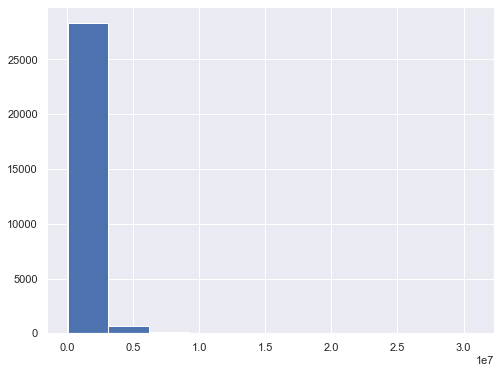

In [54]:
sns.set(rc={'figure.figsize': (8,6)})
model_data['price'].hist();

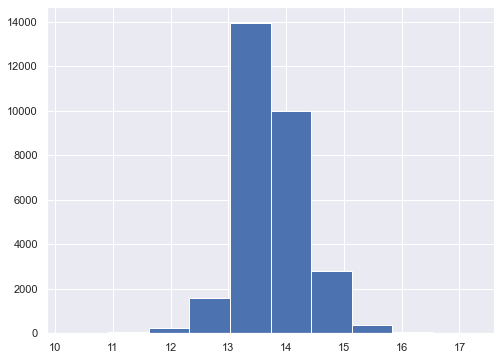

In [55]:
np.log(model_data['price']).hist();

In [77]:
y = np.log(model_data['price'])
X = sm.add_constant(model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'heat_source', 'date', 'id']))
model = sm.OLS(y, X)
model.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.711
Model:                            OLS   Adj. R-squared:                  0.710
Method:                 Least Squares   F-statistic:                     584.6
Date:                Wed, 29 Mar 2023   Prob (F-statistic):               0.00
Time:                        18:26:49   Log-Likelihood:                -7649.3
No. Observations:               29149   AIC:                         1.554e+04
Df Residuals:                   29026   BIC:                         1.656e+04
Df Model:                         122                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                      -74.7389     13.344     -5.601      0.000    -100.894     -48.584
bedrooms                     0.0056      0.003      2.066      0.039       0.000       0.011
bathrooms                    0.0444      0.004     11.612      0.000       0.037       0.052
sqft_living                  0.0001   8.69e-06     12.698      0.000    9.33e-05       0.000
sqft_lot                     0.0949      0.003     27.564      0.000       0.088       0.102
floors                      -0.0086      0.006     -1.540      0.124      -0.019       0.002
waterfront                   0.2410      0.017     13.909      0.000       0.207       0.275
sqft_above                6.612e-05   8.83e-06      7.492      0.000    4.88e-05    8.34e-05
sqft_basement            -6.283e-06   6.61e-06     -0.951      0.342   -1.92e-05    6.67e-06
sqft_garage               4.239e-05   9.63e-06      4.404      0.000    2.35e-05    6.13e-05
sqft_patio                2.954e-05   8.72e-06      3.388      0.001    1.24e-05    4.66e-05
yr_renovated              1.712e-05   4.67e-06      3.663      0.000    7.96e-06    2.63e-05
lat                          0.5752      0.119      4.814      0.000       0.341       0.809
long                        -0.4868      0.103     -4.707      0.000      -0.690      -0.284
age                          0.0003      0.000      2.462      0.014    5.23e-05       0.000
Auburn                      -0.1057      0.041     -2.586      0.010      -0.186      -0.026
Bellevue                     0.1315      0.043      3.072      0.002       0.048       0.215
Enumclaw                    -0.1269      0.051     -2.481      0.013      -0.227      -0.027
Federal Way                 -0.0465      0.035     -1.335      0.182      -0.115       0.022
Fife                        -0.0397      0.051     -0.777      0.437      -0.140       0.060
Highline                    -0.1360      0.024     -5.554      0.000      -0.184      -0.088
Issaquah                     0.0658      0.037      1.765      0.078      -0.007       0.139
Kent                        -0.0134      0.034     -0.398      0.691      -0.080       0.053
Lake Washington              0.0105      0.058      0.182      0.856      -0.103       0.124
Mercer Island                0.3412      0.022     15.627      0.000       0.298       0.384
Northshore                  -0.1572      0.063     -2.497      0.013      -0.281      -0.034
Renton                      -0.0637      0.029     -2.163      0.031      -0.121      -0.006
Riverview                   -0.1826      0.067     -2.732      0.006      -0.314      -0.052
Shoreline                   -0.0582      0.021     -2.777      0.005      -0.099      -0.017
Snoqualmie Valley           -0.0983      0.062     -1.591      0.112      -0.219       0.023
Tahoma        

## Let's explore which other variables should be transformed to be more normal

In [57]:
model_data['sqft_lot'].value_counts()

5000     479
6000     402
4000     373
7200     300
7500     181
        ... 
6970       1
11068      1
13119      1
99145      1
4098       1
Name: sqft_lot, Length: 12011, dtype: int64

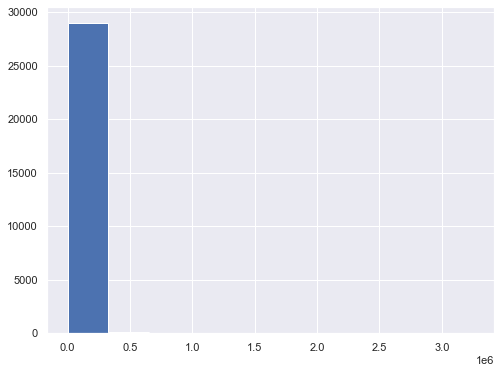

In [58]:
model_data['sqft_lot'].hist();

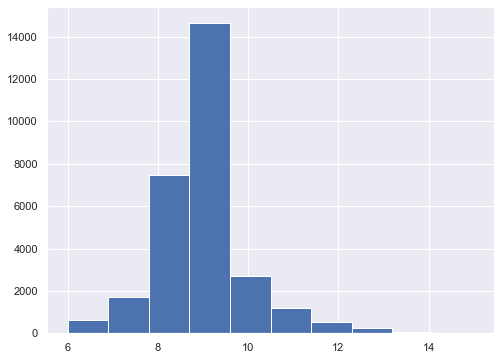

In [59]:
np.log(model_data['sqft_lot']).hist();

In [137]:
model_data['sqft_lot'] = np.log(model_data['sqft_lot'])

In [138]:
X = model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'heat_source', 'date', 'id', 'lat', 'long', 'age'])
model_unscaled = sm.OLS(y, sm.add_constant(X))
model_unscaled.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.711
Model:                            OLS   Adj. R-squared:                  0.710
Method:                 Least Squares   F-statistic:                     600.4
Date:                Thu, 30 Mar 2023   Prob (F-statistic):               0.00
Time:                        09:28:19   Log-Likelihood:                -7632.4
No. Observations:               29149   AIC:                         1.550e+04
Df Residuals:                   29029   BIC:                         1.650e+04
Df Model:                         119                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       10.7778      0.076    141.056      0.000      10.628      10.928
bedrooms                     0.0043      0.003      1.588      0.112      -0.001       0.010
bathrooms                    0.0438      0.004     11.774      0.000       0.036       0.051
sqft_living                  0.0001   8.66e-06     12.468      0.000     9.1e-05       0.000
sqft_lot                     0.9548      0.031     30.927      0.000       0.894       1.015
floors                       0.0007      0.005      0.131      0.896      -0.010       0.011
waterfront                   0.2360      0.017     13.644      0.000       0.202       0.270
sqft_above                6.185e-05   8.77e-06      7.055      0.000    4.47e-05     7.9e-05
sqft_basement             -3.19e-06   6.53e-06     -0.489      0.625    -1.6e-05     9.6e-06
sqft_garage               3.311e-05   9.39e-06      3.525      0.000    1.47e-05    5.15e-05
sqft_patio                2.891e-05    8.7e-06      3.323      0.001    1.19e-05     4.6e-05
yr_renovated              1.919e-05    4.5e-06      4.269      0.000    1.04e-05     2.8e-05
Auburn                      -0.1631      0.040     -4.072      0.000      -0.242      -0.085
Bellevue                     0.1131      0.043      2.656      0.008       0.030       0.197
Enumclaw                    -0.2149      0.050     -4.340      0.000      -0.312      -0.118
Federal Way                 -0.0831      0.034     -2.418      0.016      -0.150      -0.016
Fife                        -0.1087      0.050     -2.191      0.028      -0.206      -0.011
Highline                    -0.1531      0.024     -6.281      0.000      -0.201      -0.105
Issaquah                     0.0294      0.037      0.802      0.423      -0.043       0.101
Kent                        -0.0592      0.033     -1.785      0.074      -0.124       0.006
Lake Washington              0.0106      0.058      0.184      0.854      -0.102       0.123
Mercer Island                0.4039      0.019     20.878      0.000       0.366       0.442
Northshore                  -0.1410      0.062     -2.275      0.023      -0.262      -0.020
Renton                      -0.0841      0.029     -2.871      0.004      -0.141      -0.027
Riverview                   -0.1982      0.066     -3.014      0.003      -0.327      -0.069
Shoreline                   -0.0387      0.020     -1.904      0.057      -0.079       0.001
Snoqualmie Valley           -0.1511      0.061     -2.479      0.013      -0.271      -0.032
Tahoma                      -0.0962      0.044     -2.162      0.031      -0.183      -0.009
Tukwila                     -0.1755      0.036     -4.856      0.000      -0.246      -0.105
Vashon Island                0.0565      0.021      2.698      0.007       0.015       0.098
view_AVERAGE  

In [85]:
X = model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'heat_source', 'date', 'id'])
X

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,sqft_above,sqft_basement,sqft_garage,sqft_patio,...,grade_Excellent,grade_Luxury,grade_Mansion,grade_Substandard,grade_Poor,grade_Low,grade_Fair,grade_Low Average,grade_Good,grade_Better
0,4,1.0,1180,7140.0,1.0,0,1180,0,0,40,...,0,0,0,0,0,0,0,0,0,0
1,5,2.5,2770,6703.0,1.0,0,1570,1570,0,240,...,0,0,0,0,0,0,0,0,0,0
2,6,2.0,2880,6156.0,1.0,0,1580,1580,0,0,...,0,0,0,0,0,0,0,0,0,0
3,3,3.0,2160,1400.0,2.0,0,1090,1070,200,270,...,0,0,0,0,0,0,0,0,0,1
4,2,2.0,1120,758.0,2.0,0,1120,550,550,30,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30150,5,2.0,1910,4000.0,1.5,0,1600,1130,0,210,...,0,0,0,0,0,0,0,0,1,0
30151,3,2.0,2020,5800.0,2.0,0,2020,0,0,520,...,0,0,0,0,0,0,0,0,0,0
30152,3,2.0,1620,3600.0,1.0,0,940,920,240,110,...,0,0,0,0,0,0,0,0,0,0
30153,3,2.5,2570,2889.0,2.0,0,1830,740,480,100,...,0,0,0,0,0,0,0,0,1,0


In [139]:
X_num = model_data[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'sqft_above', 'sqft_basement', 'sqft_garage', 'sqft_patio', 'yr_renovated', 'lat', 'long', 'age']]
X_num_orig = model_data[['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'sqft_above', 'sqft_basement', 'sqft_garage', 'sqft_patio', 'yr_renovated', 'lat', 'long', 'age']]

In [140]:
scaler = StandardScaler()
X = model_data.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'heat_source', 'date', 'id'])
X_scaled = scaler.fit_transform(X_num)

In [141]:
# X_new = pd.DataFrame(data=X_new_new, columns=X.columns, index=X.index)
X_bin = model_data.drop(columns=['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'sqft_above', 'sqft_basement', 'sqft_garage', 'sqft_patio', 'yr_renovated', 'lat', 'long', 'age'])

In [142]:
# X_num = pd.DataFrame(data=X_num, columns=X_num_orig.columns, index=X_num_orig.index)
X_new = pd.DataFrame(data=X_scaled, columns=X_num_orig.columns, index=X_num_orig.index).join(X_bin)

In [144]:
X = X_new.drop(columns=['price', 'greenbelt', 'nuisance', 'condition', 'heat_source', 'date', 'id', 'lat', 'long', 'age'])
model_unscaled = sm.OLS(y, sm.add_constant(X))
model_unscaled.fit().summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.711
Model:                            OLS   Adj. R-squared:                  0.710
Method:                 Least Squares   F-statistic:                     600.4
Date:                Thu, 30 Mar 2023   Prob (F-statistic):               0.00
Time:                        09:28:41   Log-Likelihood:                -7632.4
No. Observations:               29149   AIC:                         1.550e+04
Df Residuals:                   29029   BIC:                         1.650e+04
Df Model:                         119                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                       13.3471      0.035    386.761      0.000      13.279      13.415
bedrooms                     0.0042      0.003      1.588      0.112      -0.001       0.009
bathrooms                    0.0392      0.003     11.774      0.000       0.033       0.046
sqft_living                  0.1055      0.008     12.468      0.000       0.089       0.122
sqft_lot                     0.1020      0.003     30.927      0.000       0.095       0.108
floors                       0.0004      0.003      0.131      0.896      -0.005       0.006
sqft_above                   0.0544      0.008      7.055      0.000       0.039       0.070
sqft_basement               -0.0019      0.004     -0.489      0.625      -0.009       0.006
sqft_garage                  0.0095      0.003      3.525      0.000       0.004       0.015
sqft_patio                   0.0071      0.002      3.323      0.001       0.003       0.011
yr_renovated                 0.0081      0.002      4.269      0.000       0.004       0.012
waterfront                   0.2360      0.017     13.644      0.000       0.202       0.270
Auburn                      -0.1631      0.040     -4.072      0.000      -0.242      -0.085
Bellevue                     0.1131      0.043      2.656      0.008       0.030       0.197
Enumclaw                    -0.2149      0.050     -4.340      0.000      -0.312      -0.118
Federal Way                 -0.0831      0.034     -2.418      0.016      -0.150      -0.016
Fife                        -0.1087      0.050     -2.191      0.028      -0.206      -0.011
Highline                    -0.1531      0.024     -6.281      0.000      -0.201      -0.105
Issaquah                     0.0294      0.037      0.802      0.423      -0.043       0.101
Kent                        -0.0592      0.033     -1.785      0.074      -0.124       0.006
Lake Washington              0.0106      0.058      0.184      0.854      -0.102       0.123
Mercer Island                0.4039      0.019     20.878      0.000       0.366       0.442
Northshore                  -0.1410      0.062     -2.275      0.023      -0.262      -0.020
Renton                      -0.0841      0.029     -2.871      0.004      -0.141      -0.027
Riverview                   -0.1982      0.066     -3.014      0.003      -0.327      -0.069
Shoreline                   -0.0387      0.020     -1.904      0.057      -0.079       0.001
Snoqualmie Valley           -0.1511      0.061     -2.479      0.013      -0.271      -0.032
Tahoma                      -0.0962      0.044     -2.162      0.031      -0.183      -0.009
Tukwila                     -0.1755      0.036     -4.856      0.000      -0.246      -0.105
Vashon Island                0.0565      0.021      2.698      0.007       0.015       0.098
view_AVERAGE  